In [1]:
#check if spark Context is running 
spark

In [2]:
#Checking if SQL Context is running
sqlCtx 

In [17]:
# !pip install kafka-python 
# !pip install tensorflowonspark 
# !pip install jieba  
# !pip install DBUtils  
# !pip install sparkdl   

Resource for the presentation: 
Apache Spark uses a directed acyclic graph (DAG) of computation stages (aka execution DAG). It postpones any processing until really required for actions. Spark’s lazy evaluation gives plenty of opportunities to induce low-level optimizations (so users have to know less to do more). DAGScheduler is the scheduling layer of Apache Spark that implements stage-oriented scheduling. It transforms a logical execution plan (i.e. RDD lineage of dependencies built using RDD transformations) to a physical execution plan (using stages). DAGScheduler tracks which RDDs are cached (or persisted) to avoid "recomputing" them. 

<h2>Spark Architecture</h2>
A Spark driver (aka an application’s driver process) is a JVM process that hosts SparkContext for a Spark application. It is the master node in a Spark application. It splits a Spark application into tasks and schedules them to run on executors.A driver is where the task scheduler lives and spawns tasks across workers.A driver coordinates workers and overall execution of tasks. 

Logical Execution Plan
- SparkContext and SparkConf 
- Units of Physical Execution: Jobs, Stages, Tasks and Job Groups 
- Spark Execution Engine
- Partitions and Partitioning
- Caching and Persistence 

Memory Management: 
Spark uses memory in different ways. By default Spark will leave 60% of space for RDD storage, 20% for shuffle memory,and the remaining 20% for user programs. 

For the partition: 
Spark can run 1 concurrent task for every partition of an RDD (up to the number of cores in the cluster). 
If you’re cluster has 20 cores, you should have at least 20 partitions (in practice 2–3x times more). 
From the other hand a single partition typically shouldn’t contain more than 128MB and a single shuffle 
block cannot be larger than 2GB (see SPARK-6235).   

<img src='https://jaceklaskowski.gitbooks.io/mastering-apache-spark/images/driver-sparkcontext-clustermanager-workers-executors.png'>  

<img scr='https://jaceklaskowski.gitbooks.io/mastering-apache-spark/images/dagscheduler-new-instance.png'> 

In [43]:
from pyspark import SparkContext
from pyspark.sql import SparkSession
from pyspark.sql import SQLContext
from pyspark.sql.functions import *
from pyspark.sql.types import *   
import pandas as pd 

# sc = SparkContext(appName = "dashworkshop") #create sparkcontext 
# spark = SparkSession.Builder().getOrCreate()  

#optional use spark-sumbit to do the config 
# conf = new SparkConf() 
# conf.set("spark.app.name", "spark_workshop_july_8th")
# conf.set("spark.master", "local[4]")
# conf.set("spark.ui.port", "36000") # Override the default port 

# sc = SparkContext(conf) 

<h4>use the Spark deep learning pipeline to build a mini case.Spark: fast and general engine for large scale data processing </h4>
<img src='https://msdnshared.blob.core.windows.net/media/2018/03/030218_2225_ImageDataSu1.png'>   


<h6>the Pandas and SQL style to experiment the data from Kaggle</h6> 

In [4]:
!kaggle datasets download -d kemical/kickstarter-projects 
# !pip install kaggle --upgrade 
# !chmod 600 /Users/chloeji/.kaggle/kaggle.json   

kickstarter-projects.zip: Skipping, found more recently modified local copy (use --force to force download)


In [5]:
!pwd 

/Users/chloeji/spark-2.4.3-bin-hadoop2.7


In [21]:
#sc.textFile(path, partition),the partition parameter will be applied to all further transformations and actions on this RDD.
movieDf= sc.textFile('/Users/chloeji/spark-2.4.3-bin-hadoop2.7/kickstarter-projects',18) 
movieDf

/Users/chloeji/spark-2.4.3-bin-hadoop2.7/kickstarter-projects MapPartitionsRDD[96] at textFile at NativeMethodAccessorImpl.java:0

In [22]:
movieDf.getNumPartitions() #to get the partition numbers 

18

In [9]:
# movieDf=moiveDf.coalesce(10).cache() 
movieDf.repartition(5).count  #to change the partitions we prefer 

<bound method RDD.count of MapPartitionsRDD[6] at coalesce at NativeMethodAccessorImpl.java:0>

In [10]:
%%time 

lst=list(range(10000))
rdd1 = sc.parallelize(lst) #iterative
rdd1.filter(lambda x: x % 2 != 0).collect()  
print(rdd1.getNumPartitions() ) 

8
CPU times: user 13 ms, sys: 7.92 ms, total: 20.9 ms
Wall time: 1.62 s


In [11]:
%%time 

lst=list(range(10000))
rdd2 = sc.parallelize(lst,10) #run a job with 10 tasks
rdd2.filter(lambda x: x % 2 != 0).collect()  
print(rdd2.getNumPartitions() ) 

10
CPU times: user 9.96 ms, sys: 3.95 ms, total: 13.9 ms
Wall time: 82.5 ms


In [12]:
%%time
#map and filter is most useful transformation method we will use 

lst=list(range(10000)) 
num=sc.parallelize(lst,20)
squared=num.map(lambda x: x*x if x % 2 != 0 else x).collect() 
for n in squared:
    print(n) 

0
1
2
9
4
25
6
49
8
81
10
121
12
169
14
225
16
289
18
361
20
441
22
529
24
625
26
729
28
841
30
961
32
1089
34
1225
36
1369
38
1521
40
1681
42
1849
44
2025
46
2209
48
2401
50
2601
52
2809
54
3025
56
3249
58
3481
60
3721
62
3969
64
4225
66
4489
68
4761
70
5041
72
5329
74
5625
76
5929
78
6241
80
6561
82
6889
84
7225
86
7569
88
7921
90
8281
92
8649
94
9025
96
9409
98
9801
100
10201
102
10609
104
11025
106
11449
108
11881
110
12321
112
12769
114
13225
116
13689
118
14161
120
14641
122
15129
124
15625
126
16129
128
16641
130
17161
132
17689
134
18225
136
18769
138
19321
140
19881
142
20449
144
21025
146
21609
148
22201
150
22801
152
23409
154
24025
156
24649
158
25281
160
25921
162
26569
164
27225
166
27889
168
28561
170
29241
172
29929
174
30625
176
31329
178
32041
180
32761
182
33489
184
34225
186
34969
188
35721
190
36481
192
37249
194
38025
196
38809
198
39601
200
40401
202
41209
204
42025
206
42849
208
43681
210
44521
212
45369
214
46225
216
47089
218
47961
220
48841
222
49729
224
5062

2484
6175225
2486
6185169
2488
6195121
2490
6205081
2492
6215049
2494
6225025
2496
6235009
2498
6245001
2500
6255001
2502
6265009
2504
6275025
2506
6285049
2508
6295081
2510
6305121
2512
6315169
2514
6325225
2516
6335289
2518
6345361
2520
6355441
2522
6365529
2524
6375625
2526
6385729
2528
6395841
2530
6405961
2532
6416089
2534
6426225
2536
6436369
2538
6446521
2540
6456681
2542
6466849
2544
6477025
2546
6487209
2548
6497401
2550
6507601
2552
6517809
2554
6528025
2556
6538249
2558
6548481
2560
6558721
2562
6568969
2564
6579225
2566
6589489
2568
6599761
2570
6610041
2572
6620329
2574
6630625
2576
6640929
2578
6651241
2580
6661561
2582
6671889
2584
6682225
2586
6692569
2588
6702921
2590
6713281
2592
6723649
2594
6734025
2596
6744409
2598
6754801
2600
6765201
2602
6775609
2604
6786025
2606
6796449
2608
6806881
2610
6817321
2612
6827769
2614
6838225
2616
6848689
2618
6859161
2620
6869641
2622
6880129
2624
6890625
2626
6901129
2628
6911641
2630
6922161
2632
6932689
2634
6943225
2636
6953769

5072
25735329
5074
25755625
5076
25775929
5078
25796241
5080
25816561
5082
25836889
5084
25857225
5086
25877569
5088
25897921
5090
25918281
5092
25938649
5094
25959025
5096
25979409
5098
25999801
5100
26020201
5102
26040609
5104
26061025
5106
26081449
5108
26101881
5110
26122321
5112
26142769
5114
26163225
5116
26183689
5118
26204161
5120
26224641
5122
26245129
5124
26265625
5126
26286129
5128
26306641
5130
26327161
5132
26347689
5134
26368225
5136
26388769
5138
26409321
5140
26429881
5142
26450449
5144
26471025
5146
26491609
5148
26512201
5150
26532801
5152
26553409
5154
26574025
5156
26594649
5158
26615281
5160
26635921
5162
26656569
5164
26677225
5166
26697889
5168
26718561
5170
26739241
5172
26759929
5174
26780625
5176
26801329
5178
26822041
5180
26842761
5182
26863489
5184
26884225
5186
26904969
5188
26925721
5190
26946481
5192
26967249
5194
26988025
5196
27008809
5198
27029601
5200
27050401
5202
27071209
5204
27092025
5206
27112849
5208
27133681
5210
27154521
5212
27175369
5214
2

64336441
8022
64368529
8024
64400625
8026
64432729
8028
64464841
8030
64496961
8032
64529089
8034
64561225
8036
64593369
8038
64625521
8040
64657681
8042
64689849
8044
64722025
8046
64754209
8048
64786401
8050
64818601
8052
64850809
8054
64883025
8056
64915249
8058
64947481
8060
64979721
8062
65011969
8064
65044225
8066
65076489
8068
65108761
8070
65141041
8072
65173329
8074
65205625
8076
65237929
8078
65270241
8080
65302561
8082
65334889
8084
65367225
8086
65399569
8088
65431921
8090
65464281
8092
65496649
8094
65529025
8096
65561409
8098
65593801
8100
65626201
8102
65658609
8104
65691025
8106
65723449
8108
65755881
8110
65788321
8112
65820769
8114
65853225
8116
65885689
8118
65918161
8120
65950641
8122
65983129
8124
66015625
8126
66048129
8128
66080641
8130
66113161
8132
66145689
8134
66178225
8136
66210769
8138
66243321
8140
66275881
8142
66308449
8144
66341025
8146
66373609
8148
66406201
8150
66438801
8152
66471409
8154
66504025
8156
66536649
8158
66569281
8160
66601921
8162
666345

In [52]:
%%timeit 
df_sp=spark.read.csv('ubereats_outlet_002.csv', header='true') 
df_sp.show() 

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

+--------------------+----+--------------------+----------+------------+----------+------------+
|       sourceid_uber|name|           image_url|Coke_shows|        city| food_type|Coke_in_Menu|
+--------------------+----+--------------------+----------+------------+----------+------------+
|a197a735-a30d-4ff...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|3e7e5339-6489-4dd...|None|https://d1ralsogn...|      Coke|   Melbourne|  American|        coke|
|5ee245c3-d18b-41e...|None|https://d1ralsogn...|      Coke|        None|      None|        None|
|4d84a6e7-c8dd-442...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|ab6dfe89-1ff1-4a0...|None|https://duyt4h9nf...|      Coke|        None|      None|        None|
|37fee9c7-5bbf-4e3...|None|https://d1ralsogn...|      Coke|Christchurch|  American|        coke|
|8b87a1c8-adbc-4a5...|None|htt

In [13]:
movieDf.countApproxDistinct()  

673398

Spark supports a wide range of input and output sources, Data IO 

In [23]:
movie=sc.parallelize(movieDf.collect(),10).take(100)   #collect() 
movie 

['ID,name,category,main_category,currency,deadline,goal,launched,pledged,state,backers,country,usd pledged,usd_pledged_real,usd_goal_real',
 '1000002330,The Songs of Adelaide & Abullah,Poetry,Publishing,GBP,2015-10-09,1000.00,2015-08-11 12:12:28,0.00,failed,0,GB,0.00,0.00,1533.95',
 '1000003930,Greeting From Earth: ZGAC Arts Capsule For ET,Narrative Film,Film & Video,USD,2017-11-01,30000.00,2017-09-02 04:43:57,2421.00,failed,15,US,100.00,2421.00,30000.00',
 '1000004038,Where is Hank?,Narrative Film,Film & Video,USD,2013-02-26,45000.00,2013-01-12 00:20:50,220.00,failed,3,US,220.00,220.00,45000.00',
 '1000007540,ToshiCapital Rekordz Needs Help to Complete Album,Music,Music,USD,2012-04-16,5000.00,2012-03-17 03:24:11,1.00,failed,1,US,1.00,1.00,5000.00',
 '1000011046,Community Film Project: The Art of Neighborhood Filmmaking,Film & Video,Film & Video,USD,2015-08-29,19500.00,2015-07-04 08:35:03,1283.00,canceled,14,US,1283.00,1283.00,19500.00',
 '1000014025,Monarch Espresso Bar,Restaurants,Fo

In [24]:
movieDf.persist() #.cache() 

/Users/chloeji/spark-2.4.3-bin-hadoop2.7/kickstarter-projects MapPartitionsRDD[96] at textFile at NativeMethodAccessorImpl.java:0

In [25]:
movieDf.first()  #RDD first 

'ID,name,category,main_category,currency,deadline,goal,launched,pledged,state,backers,country,usd pledged,usd_pledged_real,usd_goal_real'

In [17]:
movieDf.map(lambda x: x['country']).filter(lambda x: x=='FR')  

PythonRDD[18] at RDD at PythonRDD.scala:53

In [27]:
df = spark.read.format("com.databricks.spark.csv").\
options(header="true", \
        inferschema="true").\
load("/Users/chloeji/spark-2.4.3-bin-hadoop2.7/kickstarter-projects",header=True) 

df.show(100)
df.printSchema() 

+----------+--------------------+--------------------+-------------+--------+----------+----------+-------------------+-------------------+----------+----------+-------+-----------+----------------+-------------+
|        ID|                name|            category|main_category|currency|  deadline|      goal|           launched|            pledged|     state|   backers|country|usd pledged|usd_pledged_real|usd_goal_real|
+----------+--------------------+--------------------+-------------+--------+----------+----------+-------------------+-------------------+----------+----------+-------+-----------+----------------+-------------+
|1000002330|The Songs of Adel...|              Poetry|   Publishing|     GBP|2015-10-09|   1000.00|2015-08-11 12:12:28|               0.00|    failed|         0|     GB|       0.00|            0.00|      1533.95|
|1000003930|Greeting From Ear...|      Narrative Film| Film & Video|     USD|2017-11-01|  30000.00|2017-09-02 04:43:57|            2421.00|    faile

In [28]:
type(df) 

pyspark.sql.dataframe.DataFrame

In [29]:
df.filter(df['country']=='FR')\
.select(['ID','country','category', 'name']).show(10) #where 

+----------+-------+----------------+--------------------+
|        ID|country|        category|                name|
+----------+-------+----------------+--------------------+
| 100089599|     FR|         Apparel|CLOTHING LABEL WI...|
|1000916036|     FR| Performance Art|Conference Paradi...|
|1001216413|     FR|  Product Design|Road Runner multi...|
|1002597730|     FR|     Video Games|     Dungeons Heroes|
| 100525355|     FR|     Video Games| The Stolen Crystals|
| 100609913|     FR|           Vegan|Martin Persil, la...|
|1007112532|     FR|      Technology|LoopBall: the fir...|
|1007343920|     FR|         Gadgets|RRED: navigation ...|
|1007882169|     FR|    Music Videos|"New Video Music ...|
|1009173491|     FR|Children's Books|Un toit entre nou...|
+----------+-------+----------------+--------------------+
only showing top 10 rows



In [30]:
df.filter(df['country']=='FR')\
.select(['country','category', 'name','usd pledged'])\
.orderBy(df['usd pledged'].desc(),df['name'])\
.show(10) 

+-------+--------------+--------------------+------------+
|country|      category|                name| usd pledged|
+-------+--------------+--------------------+------------+
|     FR|Product Design|Robust Domino - A...| 992.7245838|
|     FR|Product Design|Robust Domino - A...|      992.72|
|     FR|   Video Games|Pirates: Age of G...| 990.8334689|
|     FR|   Video Games|Pirates: Age of G...|      990.83|
|     FR|       Gadgets|Small GPS Tracker...|       99.30|
|     FR|       Gadgets|Small GPS Tracker...| 99.29881456|
|     FR|        Drinks|Khan Luxury Premi...|      989.26|
|     FR|        Drinks|Khan Luxury Premi...|989.25669165|
|     FR|Tabletop Games|StartUp, un jeu d...|      989.21|
|     FR|Tabletop Games|StartUp, un jeu d...|989.20617978|
+-------+--------------+--------------------+------------+
only showing top 10 rows



In [31]:
df.groupBy('name').count().show() 

+--------------------+-----+
|                name|count|
+--------------------+-----+
|WE ARE ONE: STREE...|    2|
|The Great Kentuck...|    2|
|Peak View Brewing...|    2|
|Little Boy Wonder...|    2|
|"Artlysium Presen...|    2|
|Gamerline Clothin...|    2|
|Disgruntled Decks...|    2|
|Thank You Letters...|    2|
|Z Day by Lena Pen...|    2|
|Fotomodel Lisa va...|    2|
|"Scorpius Dance T...|    2|
|     Uncommon Action|    2|
|Drift Plates X1 B...|    2|
|           Revoltoso|    2|
|quia non numquam ...|    2|
|          The Farmer|    4|
|Be a Turtle (and ...|    1|
|    Hodgello's Blood|    2|
|         Micro Match|    2|
|              Knits+|    2|
+--------------------+-----+
only showing top 20 rows



In [32]:
from pyspark.sql.functions import desc

df.groupBy('country').count().filter("`count`>2000").sort(desc("count")).show() 

+-------+------+
|country| count|
+-------+------+
|     US|547916|
|     GB| 61102|
|     CA| 26708|
|     AU| 14048|
|     DE|  6845|
|     NL|  5121|
|     FR|  4838|
|     IT|  4616|
|  N,0""|  3790|
|"N,""0"|  3783|
|     ES|  3643|
|     SE|  3025|
|     NZ|  2579|
+-------+------+



In [33]:
from pyspark.sql.functions import col 

df.filter(col('country')=='DE').filter(col('usd pledged')>100000) \
.select('ID','country', 'category','name','usd pledged').show() 

+----------+-------+----------------+--------------------+-----------+
|        ID|country|        category|                name|usd pledged|
+----------+-------+----------------+--------------------+-----------+
| 100635918|     DE|        Hardware|World's first wir...|  193622.51|
|1009154287|     DE|  Product Design|ZIPPELIN: An infl...|  148197.14|
|1021260036|     DE|        Hardware|YOUMO - Your Smar...|  197140.88|
|1136359599|     DE|        Hardware|The first plug & ...|  615908.67|
|  11439199|     DE|        Hardware|Kiën Light: Intel...|  133799.88|
|1208264559|     DE|  Product Design|MIITO – the susta...|  912907.01|
|1231508817|     DE|          Design|ComfyLight - The ...|  142252.29|
|1248088162|     DE|        Hardware|Noki: The smart d...|  430201.74|
| 126918586|     DE|Camera Equipment|solidLUUV: The Al...|  367300.46|
|1365570388|     DE|      Technology|Mellow – The Elec...|  345900.84|
|1392671263|     DE|      Technology|PACE - Mach dein ...|  378489.09|
|14032

In [34]:
from pyspark.sql.functions import udf
upper = udf(lambda s: s.upper())
df.select(upper(df['name'])).show(10)  

+--------------------+
|      <lambda>(name)|
+--------------------+
|THE SONGS OF ADEL...|
|GREETING FROM EAR...|
|      WHERE IS HANK?|
|TOSHICAPITAL REKO...|
|COMMUNITY FILM PR...|
|MONARCH ESPRESSO BAR|
|SUPPORT SOLAR ROA...|
|CHASER STRIPS. OU...|
|SPIN - PREMIUM RE...|
|STUDIO IN THE SKY...|
+--------------------+
only showing top 10 rows



In [35]:
#Create a SQL view 
df.createTempView("kickstarterView")
sqlContext.sql("SELECT * FROM kickstarterView").show() 

+----------+--------------------+--------------+-------------+--------+----------+---------+-------------------+--------+----------+-------+-------+-----------+----------------+-------------+
|        ID|                name|      category|main_category|currency|  deadline|     goal|           launched| pledged|     state|backers|country|usd pledged|usd_pledged_real|usd_goal_real|
+----------+--------------------+--------------+-------------+--------+----------+---------+-------------------+--------+----------+-------+-------+-----------+----------------+-------------+
|1000002330|The Songs of Adel...|        Poetry|   Publishing|     GBP|2015-10-09|  1000.00|2015-08-11 12:12:28|    0.00|    failed|      0|     GB|       0.00|            0.00|      1533.95|
|1000003930|Greeting From Ear...|Narrative Film| Film & Video|     USD|2017-11-01| 30000.00|2017-09-02 04:43:57| 2421.00|    failed|     15|     US|     100.00|         2421.00|     30000.00|
|1000004038|      Where is Hank?|Narrati

In [56]:
sqlContext.sql('''
SELECT ID, name, category, `usd pledged`
    FROM kickstarterView 
    where (country= 'DE')and (goal>5000) 
    limit 20
''').show() 

+----------+--------------------+---------------+-----------+
|        ID|                name|       category|usd pledged|
+----------+--------------------+---------------+-----------+
|1000338818|Diet! No thanks, ...|     Publishing|      22.35|
|1001190550| Sanfilippo Wing it!|    Accessories|     966.76|
|1001494526|       Dream Project|            Art|       0.00|
|1004236435|The Atari ST and ...|    Anthologies|    8274.42|
|1004304382|Mars Transit game...| Tabletop Games|    2443.68|
|1005018489|Perfect Boots - F...|       Footwear|   38934.75|
|1005397520|REDS.box - Get yo...|       Hardware|   36950.77|
|1005423973|Bocusini - World'...|    3D Printing|   45283.87|
| 100635918|World's first wir...|       Hardware|  193622.51|
|1008311896|TheOnlyOne (Cance...|Gaming Hardware|      11.35|
|1009154287|ZIPPELIN: An infl...| Product Design|  148197.14|
|1010661105|4-stage installat...|     Technology|    5268.42|
|1012497254|One Line - One Wo...| Graphic Design|     949.09|
|1012837

In [57]:
#pythonic style or u can use hiveCtx.sql
df.filter(col('country')=='DE').filter(col('goal')>5000).select('ID', 'name', 'category', 'usd pledged').show(20)     

+----------+--------------------+---------------+-----------+
|        ID|                name|       category|usd pledged|
+----------+--------------------+---------------+-----------+
|1000338818|Diet! No thanks, ...|     Publishing|      22.35|
|1001190550| Sanfilippo Wing it!|    Accessories|     966.76|
|1001494526|       Dream Project|            Art|       0.00|
|1004236435|The Atari ST and ...|    Anthologies|    8274.42|
|1004304382|Mars Transit game...| Tabletop Games|    2443.68|
|1005018489|Perfect Boots - F...|       Footwear|   38934.75|
|1005397520|REDS.box - Get yo...|       Hardware|   36950.77|
|1005423973|Bocusini - World'...|    3D Printing|   45283.87|
| 100635918|World's first wir...|       Hardware|  193622.51|
|1008311896|TheOnlyOne (Cance...|Gaming Hardware|      11.35|
|1009154287|ZIPPELIN: An infl...| Product Design|  148197.14|
|1010661105|4-stage installat...|     Technology|    5268.42|
|1012497254|One Line - One Wo...| Graphic Design|     949.09|
|1012837

In [36]:
from pyspark.sql import SQLContext 

sqlContext = SQLContext(sc)

columns = ['id', 'city', 'country']
vals = [(1, 'berlin', 'germany'),
        (2, 'shanghai', 'china'),
        (3,'new york', 'usa'),
        (4, 'london', 'gb')] 

dfCity= spark.createDataFrame(vals, columns) 
dfCity.show()   

+---+--------+-------+
| id|    city|country|
+---+--------+-------+
|  1|  berlin|germany|
|  2|shanghai|  china|
|  3|new york|    usa|
|  4|  london|     gb|
+---+--------+-------+



<h4>Connect to AWS S3</h4> 

In [57]:
#config the s3 bucket in the pyspark with Hadoop config file 

hadoop_conf = spark.sparkContext._jsc.hadoopConfiguration()
hadoop_conf.set("fs.s3a.impl", "org.apache.hadoop.fs.s3a.S3AFileSystem")
# hadoop_conf.set("fs.s3a.access.key", "")
# hadoop_conf.set("fs.s3a.secret.key", "") 

<strong>Deep Learning Pipelines</strong> includes utility functions that can load millions of images into a Spark DataFrame and decode them automatically in a distributed fashion, allowing manipulationg at scale. 
- It provides easy-to-use APIs that enable deep learning in very few lines of code.
- It uses Spark's powerful distributed engine to scale out deep learning on massive datasets. 

<a href='https://issues.apache.org/jira/browse/SPARK-21866'>Debug</a> that in stack overflow 

In [58]:
from pyspark.ml.image import ImageSchema #use imageschema to read image 
from sparkdl import readImages 

# sc.textFile("s3n://dash-external-data/food_image/ubereats/").count()  
image_df = ImageSchema.readImages("s3a://dash-external-data/food_image/ubereats") 
display(image_df) 

DataFrame[image: struct<origin:string,height:int,width:int,nChannels:int,mode:int,data:binary>]

In [59]:
image_df.columns 

['image']

In [60]:
display(image_df.select("image.origin")) 

DataFrame[origin: string]

In [61]:
image_df.printSchema()  
#string representing the source URI 
#integer, image height/width in pixels
#nChannels:number of image channels  
#mode: IntegerType (OpenCV-compatible type)  

root
 |-- image: struct (nullable = true)
 |    |-- origin: string (nullable = true)
 |    |-- height: integer (nullable = false)
 |    |-- width: integer (nullable = false)
 |    |-- nChannels: integer (nullable = false)
 |    |-- mode: integer (nullable = false)
 |    |-- data: binary (nullable = false)



In [62]:
image_df.cache()  #persist  

DataFrame[image: struct<origin:string,height:int,width:int,nChannels:int,mode:int,data:binary>]

In [32]:
#In PySpark we provide Spark SQL data source API for loading image data as DataFrame. 
#Spark extracting values from a Row to decode the image info
df=image_df.select("image.origin", "image.width", "image.height", 
                   'image.mode', 'image.nChannels').show(truncate=False) 
df 

+---------------------------------------------------------------------------------+-----+------+----+---------+
|origin                                                                           |width|height|mode|nChannels|
+---------------------------------------------------------------------------------+-----+------+----+---------+
|s3a://dash-external-data/food_image/ubereats/000941a5e3b48e7fa088e9879578ffe2.jpg|550  |440   |16  |3        |
|s3a://dash-external-data/food_image/ubereats/000d12901fca2b31b854d6c9a986d37c.jpg|550  |440   |16  |3        |
|s3a://dash-external-data/food_image/ubereats/000e7bbd0ea1cba11d685f24a0b275a7.jpg|550  |440   |16  |3        |
|s3a://dash-external-data/food_image/ubereats/001112996c8b2bb95f4d0878a8fb47f4.jpg|550  |440   |16  |3        |
|s3a://dash-external-data/food_image/ubereats/00124f9f14f3ab3c5028d43999e4b6b7.jpg|550  |440   |16  |3        |
|s3a://dash-external-data/food_image/ubereats/00156c305fa8014af5dee2b33d56b279.jpg|550  |440   |16  |3  

In [34]:
img_url=image_df.select("image.origin").show(truncate=False)  

+---------------------------------------------------------------------------------+
|origin                                                                           |
+---------------------------------------------------------------------------------+
|s3a://dash-external-data/food_image/ubereats/000941a5e3b48e7fa088e9879578ffe2.jpg|
|s3a://dash-external-data/food_image/ubereats/000d12901fca2b31b854d6c9a986d37c.jpg|
|s3a://dash-external-data/food_image/ubereats/000e7bbd0ea1cba11d685f24a0b275a7.jpg|
|s3a://dash-external-data/food_image/ubereats/001112996c8b2bb95f4d0878a8fb47f4.jpg|
|s3a://dash-external-data/food_image/ubereats/00124f9f14f3ab3c5028d43999e4b6b7.jpg|
|s3a://dash-external-data/food_image/ubereats/00156c305fa8014af5dee2b33d56b279.jpg|
|s3a://dash-external-data/food_image/ubereats/001c59fdc3e952d06c2b331ddea9adc6.jpg|
|s3a://dash-external-data/food_image/ubereats/001d2812d03856cfb228d6b9018e71e8.jpg|
|s3a://dash-external-data/food_image/ubereats/001e00dc510a4abb354af3efd8c9f1

In [64]:
s3_img=image_df.take(10) #show the bytes from the images 
s3_img.show() 

[Row(image=Row(origin='s3a://dash-external-data/food_image/ubereats/000941a5e3b48e7fa088e9879578ffe2.jpg', height=440, width=550, nChannels=3, mode=16, data=bytearray(b'\x10\x9e]\x10\x9b^\x00wB\x00{K\t\xa0o\x00\x9ah\t\xa9s\x00\x95\\\x00\x8aP\x1c\xa6l\x0e\x92]\x00\x89S\x00\x96_\x12\xb6|5\xcd\x92=\xce\x90\n\x8fQ\x00\x80@\x00\x95P*\xd2\x8d\x16\xc3\x7f\x02\xabl\x01\x99d\x00\x82P\n\xa1s\x1b\xa9z\x05uK\x002\r\x0f.\x13\x13\x1d\x0c\x11\x19\x0e\x11\x19\x12\x10\x16\x11\x17\x1d\x18\x0f\x16\x13\x0f\x18\x152A=M\\XWe_\xab\xaf\xa9\xea\xdf\xdb\xe2\xd4\xce\xc7\xc1\xba\xa8\xa2\x9b\xb0\xa3\xa1\xb2\xa6\xa4\xa9\xa7\xa6\xa3\xa6\xa4\xa9\xa7\xa6\xad\xa9\xa8\xb0\xac\xab\xb1\xad\xac\xb0\xab\xac\xaf\xaa\xab\xae\xa9\xaa\xad\xa8\xa9\xae\xaa\xa9\xae\xaa\xa9\xaf\xab\xaa\xaf\xab\xaa\xaf\xac\xa8\xaf\xac\xa8\xb1\xae\xa9\xb2\xaf\xaa\xaf\xab\xa6\xaf\xab\xa6\xae\xaa\xa5\xaf\xab\xa6\xaf\xab\xa6\xae\xaa\xa5\xad\xa8\xa5\xab\xa6\xa3\xad\xa8\xa5\xaf\xaa\xa7\xb0\xab\xa8\xb0\xab\xa8\xaf\xaa\xa7\xaf\xaa\xa7\xb1\xac\xab\xb3\xae\xa

In [ ]:
#make the binary to noarray 

In [4]:
# from PIL import Image 
# images = sc.binaryFiles("s3a://dash-external-data/food_image/ubereats")
# image_to_array = lambda rd: np.asarray(Image.open(StringIO(rd)))
# images.values().map(image_to_array).take(5) 

In [68]:
# change the RDD to the DF 
df=image_df.toDF
df 

<bound method DataFrame.toDF of DataFrame[image: struct<origin:string,height:int,width:int,nChannels:int,mode:int,data:binary>]>

<h4>How to use the Deep learning pipeline API for the CNN</h4> 
check first the example of the image from databricks and then play round for it with image reconition task <br/>  
what is the <a href='https://github.com/databricks/spark-deep-learning'>deep learning pipeline</a><br/> 

It uses Spark's powerful distributed engine to scale out deep learning on massive datasets. <br/> 
Currently, TensorFlow and TensorFlow-backed Keras workflows are supported, with a focus on: 

- large-scale inference / scoring/ pre_built model for transfer learning ( one commonly used technique in deep learning, the similar task for the customized data)  
- transfer learning and hyperparameter tuning on image data 
- turn deep learning models into SQL functions that can be used by a much wider group of users(such as data analyst or business department) 

In [69]:
!curl -O http://download.tensorflow.org/example_images/flower_photos.tgz  
!tar xzf flower_photos.tgz  
!mkdir flower_photos/example 
# !rm flower_photos/LICENSE.txt  

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  218M  100  218M    0     0  8137k      0  0:00:27  0:00:27 --:--:-- 9442k1k      0  0:07:16  0:00:02  0:07:14  511k0     0  7505k      0  0:00:29  0:00:13  0:00:16 9124k
mkdir: flower_photos/example: File exists


In [3]:
!ls flower_photos  

daisy      dandelion  example    roses      sample     sunflowers tulips


In [4]:
!ls flower_photos/daisy | head -10
!ls flower_photos/dandelion | head -10  

100080576_f52e8ee070_n.jpg
10140303196_b88d3d6cec.jpg
10172379554_b296050f82_n.jpg
10172567486_2748826a8b.jpg
10172636503_21bededa75_n.jpg
102841525_bd6628ae3c.jpg
1031799732_e7f4008c03.jpg
10391248763_1d16681106_n.jpg
10437754174_22ec990b77_m.jpg
10437770546_8bb6f7bdd3_m.jpg
10043234166_e6dd915111_n.jpg
10200780773_c6051a7d71_n.jpg
10294487385_92a0676c7d_m.jpg
10437652486_aa86c14985.jpg
10443973_aeb97513fc_m.jpg
10477378514_9ffbcec4cf_m.jpg
10486992895_20b344ce2d_n.jpg
10617162044_8740d4dd9f_n.jpg
10617191174_9a01753241_n.jpg
10683189_bd6e371b97.jpg


In [5]:
!cp flower_photos/daisy/100080576_f52e8ee070_n.jpg flower_photos/example/
!cp flower_photos/daisy/10140303196_b88d3d6cec.jpg flower_photos/example/
!cp flower_photos/tulips/11746548_26b3256922_n.jpg flower_photos/example/  
!cp flower_photos/dandelion/10683189_bd6e371b97.jpg flower_photos/example/  

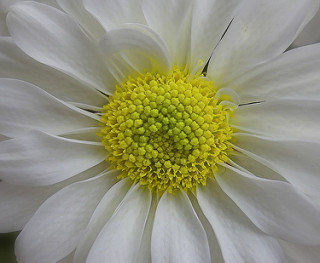

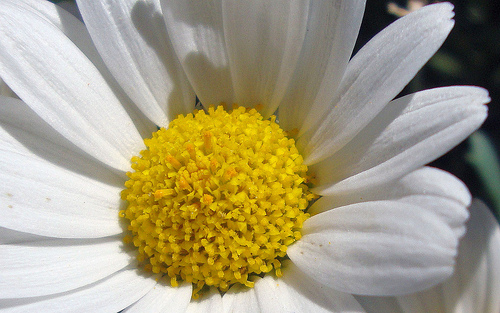

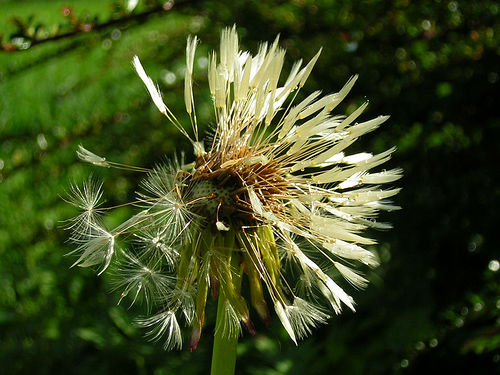

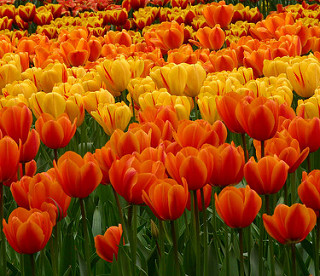

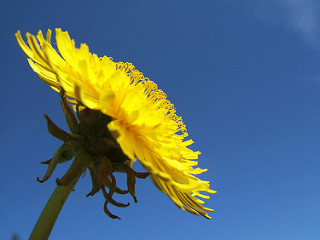

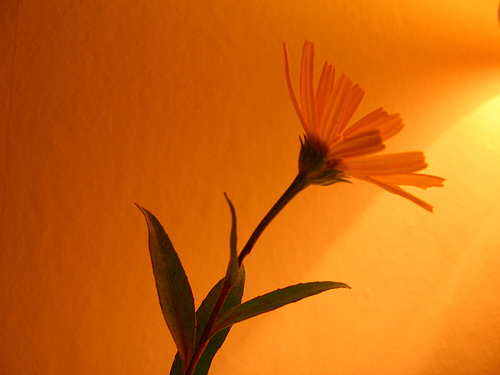

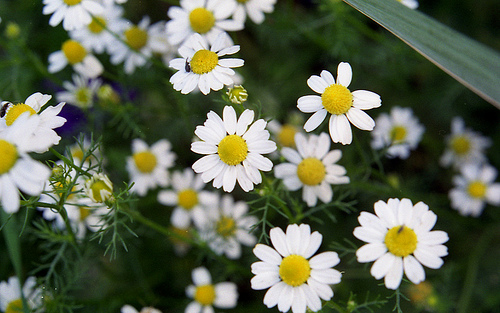

In [6]:
import IPython.display as dp

fs = !ls flower_photos/example/*.jpg

def show_me_flower():
    images = []
    for ea in fs:
        images.append(dp.Image(filename=ea, format='png'))
    for ea in images:
        dp.display_png(ea)   

show_me_flower() 

# from PIL import Image
# import matplotlib.pyplot as plt 

# plt.imshow(Image.open('flower_photos/daisy/10140303196_b88d3d6cec.jpg')) 
# plt.show()  

In [9]:
from sparkdl import readImages
image_df_flower = readImages("./flower_photos/example/") 
image_df_flower.show() #check the RGBpixel range for each image  

Using TensorFlow backend.
/Users/chloeji/anaconda3/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning: compiletime version 3.6 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.7
  return f(*args, **kwds)


+--------------------+--------------------+
|            filePath|               image|
+--------------------+--------------------+
|file:/Users/chloe...|[RGB, 240, 320, 3...|
|file:/Users/chloe...|[RGB, 375, 500, 3...|
|file:/Users/chloe...|[RGB, 313, 500, 3...|
|file:/Users/chloe...|[RGB, 276, 320, 3...|
|file:/Users/chloe...|[RGB, 313, 500, 3...|
|file:/Users/chloe...|[RGB, 375, 500, 3...|
|file:/Users/chloe...|[RGB, 263, 320, 3...|
+--------------------+--------------------+



In [10]:
image_df_flower.printSchema() 

root
 |-- filePath: string (nullable = false)
 |-- image: struct (nullable = true)
 |    |-- mode: string (nullable = false)
 |    |-- height: integer (nullable = false)
 |    |-- width: integer (nullable = false)
 |    |-- nChannels: integer (nullable = false)
 |    |-- data: binary (nullable = false)



In [30]:
image_df_flower.select("filePath", 'image.height', 'image.width').show(truncate=False) 

+----------------------------------------------------------------------------------------------+------+-----+
|filePath                                                                                      |height|width|
+----------------------------------------------------------------------------------------------+------+-----+
|file:/Users/chloeji/spark-2.4.3-bin-hadoop2.7/flower_photos/example/151861297_55b10a03a6_n.jpg|240   |320  |
|file:/Users/chloeji/spark-2.4.3-bin-hadoop2.7/flower_photos/example/267148092_4bb874af58.jpg  |375   |500  |
|file:/Users/chloeji/spark-2.4.3-bin-hadoop2.7/flower_photos/example/6210664514_f1d211217a.jpg |313   |500  |
|file:/Users/chloeji/spark-2.4.3-bin-hadoop2.7/flower_photos/example/11746548_26b3256922_n.jpg |276   |320  |
|file:/Users/chloeji/spark-2.4.3-bin-hadoop2.7/flower_photos/example/10140303196_b88d3d6cec.jpg|313   |500  |
|file:/Users/chloeji/spark-2.4.3-bin-hadoop2.7/flower_photos/example/10683189_bd6e371b97.jpg   |375   |500  |
|file:/Use

In [33]:
def flowers():
    classes = {}
    file_name_set = set()
    file_name_class = {}

    image_path = 'flower_photos'
    for dir_name in os.listdir(image_path):
        if os.path.isdir(image_path + '/' + dir_name):
            classes.setdefault(dir_name, float(len(classes) + 1))
            for file_name in os.listdir(image_path + '/' + dir_name):
                if file_name in file_name_set:
                    file_name_set.add(file_name)
                    file_name_class[file_name] = classes[dir_name]
            
    return classes, file_name_class

classes, train_image_to_class = flowers()   

In [35]:
classes 

{'roses': 1.0,
 'sunflowers': 2.0,
 'daisy': 3.0,
 'example': 4.0,
 'sample': 5.0,
 'dandelion': 6.0,
 'tulips': 7.0}

<h4>Deep learning for image recognition</h4> 
concept explaintion  

In [15]:
sunflower_df = imageIO.readImages("./flower_photos/sunflowers").withColumn("label", lit(1))
sunflower_df

DataFrame[filePath: string, image: struct<mode:string,height:int,width:int,nChannels:int,data:binary>, label: int]

In [35]:
daisy_df=imageIO.readImages("./flower_photos/daisy").withColumn("label", lit(1))
daisy_df 

DataFrame[filePath: string, image: struct<mode:string,height:int,width:int,nChannels:int,data:binary>, label: int]

In [13]:
from pyspark.ml.image import ImageSchema
from pyspark.sql.functions import lit
from sparkdl.image import imageIO

sunflowers_df = imageIO.readImages("./flower_photos/sunflowers").withColumn("label", lit(1))
daisy_df=imageIO.readImages("./flower_photos/daisy").withColumn("label", lit(1))

daisy_train, daisy_test, _ = daisy_df.randomSplit([0.1, 0.05, 0.85])  
sunflowers_train, sunflowers_test, _ = sunflowers_df.randomSplit([0.1, 0.05, 0.85]) 
print(daisy_test) 
print(sunflowers_test) 
train_df= daisy_train.unionAll(sunflowers_train)
test_df = daisy_test.unionAll(sunflowers_test) 

# Under the hood, each of the partitions is fully loaded in memory, which may be expensive.
# This ensure that each of the paritions has a small size.
train_df = train_df.repartition(10) 
test_df = test_df.repartition(10)  

DataFrame[filePath: string, image: struct<mode:string,height:int,width:int,nChannels:int,data:binary>, label: int]
DataFrame[filePath: string, image: struct<mode:string,height:int,width:int,nChannels:int,data:binary>, label: int]


<a href=' https://forums.databricks.com/questions/13320/check-whether-your-graphdef-interpreting-binary-is.html'>GraphDef issue</a> <br/> 
 version compatibility <a href='https://github.com/tensorflow/models/issues/4093'>issue</a> check this one from GH 
 
 <img src='graphdf_issue.png'>  

In [16]:
from pyspark.ml.classification import LogisticRegression
from pyspark.ml import Pipeline
from sparkdl import DeepImageFeaturizer 

featurizer = DeepImageFeaturizer(inputCol="image", outputCol="features", modelName="InceptionV3")

lr = LogisticRegression(maxIter=10, regParam=0.05, elasticNetParam=0.3, labelCol="label")
p = Pipeline(stages=[featurizer, lr])

p_model = p.fit(train_df) 

INFO:tensorflow:Froze 376 variables.


2019-07-08 14:10:58,971 INFO (MainThread-70555) Froze 376 variables.


Converted 376 variables to const ops.
INFO:tensorflow:Froze 0 variables.


2019-07-08 14:12:02,790 INFO (MainThread-70555) Froze 0 variables.


Converted 0 variables to const ops.


2019-07-08 14:12:03,852 INFO (MainThread-70555) Fetch names: ['sdl_flattened_mixed10/concat:0']
2019-07-08 14:12:03,867 INFO (MainThread-70555) Spark context = <SparkContext master=local[*] appName=PySparkShell>
2019-07-08 14:12:04,734 INFO (MainThread-70555) fetches: ['sdl_flattened_mixed10/concat:0'] [[-1]]
2019-07-08 14:12:04,735 INFO (MainThread-70555) inputs: ['height:0', 'width:0', 'num_channels:0', 'image_buffer:0', 'shape/shape:0', 'expanded/dim:0', 'given/truediv/y:0', 'given/sub/y:0', 'given/conv2d_1/kernel:0', 'given/batch_normalization_1/beta:0', 'given/batch_normalization_1/moving_mean:0', 'given/batch_normalization_1/moving_variance:0', 'given/batch_normalization_1/ones_like/Shape:0', 'given/batch_normalization_1/ones_like/Const:0', 'given/conv2d_2/kernel:0', 'given/batch_normalization_2/beta:0', 'given/batch_normalization_2/moving_mean:0', 'given/batch_normalization_2/moving_variance:0', 'given/batch_normalization_2/ones_like/Shape:0', 'given/batch_normalization_2/ones_l

2019-07-08 14:12:05,123 INFO (MainThread-70555) inputs: ['height', 'width', 'num_channels', 'image_buffer', 'shape/shape', 'expanded/dim', 'given/truediv/y', 'given/sub/y', 'given/conv2d_1/kernel', 'given/batch_normalization_1/beta', 'given/batch_normalization_1/moving_mean', 'given/batch_normalization_1/moving_variance', 'given/batch_normalization_1/ones_like/Shape', 'given/batch_normalization_1/ones_like/Const', 'given/conv2d_2/kernel', 'given/batch_normalization_2/beta', 'given/batch_normalization_2/moving_mean', 'given/batch_normalization_2/moving_variance', 'given/batch_normalization_2/ones_like/Shape', 'given/batch_normalization_2/ones_like/Const', 'given/conv2d_3/kernel', 'given/batch_normalization_3/beta', 'given/batch_normalization_3/moving_mean', 'given/batch_normalization_3/moving_variance', 'given/batch_normalization_3/ones_like/Shape', 'given/batch_normalization_3/ones_like/Const', 'given/conv2d_4/kernel', 'given/batch_normalization_4/beta', 'given/batch_normalization_4/mo

IllegalArgumentException: 'NodeDef mentions attr \'dilations\' not in Op<name=Conv2D; signature=input:T, filter:T -> output:T; attr=T:type,allowed=[DT_HALF, DT_FLOAT, DT_DOUBLE]; attr=strides:list(int); attr=use_cudnn_on_gpu:bool,default=true; attr=padding:string,allowed=["SAME", "VALID"]; attr=data_format:string,default="NHWC",allowed=["NHWC", "NCHW"]>; NodeDef: given/conv2d_1/convolution = Conv2D[T=DT_FLOAT, data_format="NHWC", dilations=[1, 1, 1, 1], padding="VALID", strides=[1, 2, 2, 1], use_cudnn_on_gpu=true](given/sub, given/conv2d_1/kernel/read). (Check whether your GraphDef-interpreting binary is up to date with your GraphDef-generating binary.).'

In [ ]:
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
from pyspark.sql.types import DoubleType
from pyspark.sql.functions import expr
from pyspark.sql.functions import *
from pyspark.sql.types import *


tested_df = p_model.transform(test_df)
evaluator = MulticlassClassificationEvaluator(metricName="accuracy")
print("Test set accuracy = " + str(evaluator.evaluate(tested_df.select("prediction", "label")))) 

def _p1(v):
    return float(v.array[1])
take_one = udf(_p1, DoubleType())

df = tested_df.withColumn("p", take_one(tested_df.probability))
wrong_df = df.orderBy(expr("abs(p - label)"), ascending=False)
wrong_df.select("image.origin", "p", "label").show(10) 

<h4>Deploying Models in SQL</h4> 

In [ ]:
sparkdl.registerKerasUDF("img_classify", "/models/flowermodel.h5") 
SELECT image, img_classify(image) label FROM images 
WHERE contains(label, “sunflowers”) 

images = spark.readImages(IMAGE_PATH, recursive = True, sampleRatio = 0.1).cache()

images.printSchema()

print(images.count())  